<a href="https://colab.research.google.com/github/evi03/PCVK_Semester5/blob/main/Percobaan2_UASFinalProject_PCVK_Kelompok2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **KELOMPOK 2 TI-3A**

**Nama Anggota :**
*   Evi Amalia Midfia
*   Kurniawati Agustina
*   Widya Indah Puspita Sari

### **Import Library**

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import zipfile

## **Training Dataset MNIST**

#### Load MNIST

In [ ]:
from tensorflow.keras.datasets import mnist

In [ ]:
(train_data, train_labels), (test_data, test_labels) = mnist.load_data()

11490434/11490434 [==============================] - 0s 0us/step


In [ ]:
# Check shape data
(train_data.shape, test_data.shape)

((60000, 28, 28), (10000, 28, 28))

In [ ]:
# Check shape labels
(train_labels.shape, test_labels.shape)

((60000,), (10000,))

In [ ]:
# Check each data shape --> should be 28*28
train_data[0].shape

(28, 28)

In [ ]:
# Check the label
train_labels.shape

(60000,)

### Combine Train and Test Data

In [ ]:
digits_data = np.vstack([train_data, test_data])
digits_labels = np.hstack([train_labels, test_labels])

In [ ]:
# Check data shape
digits_data.shape

(70000, 28, 28)

In [ ]:
# Check label shape
digits_labels.shape

(70000,)

Text(0.5, 1.0, 'Class: 4')

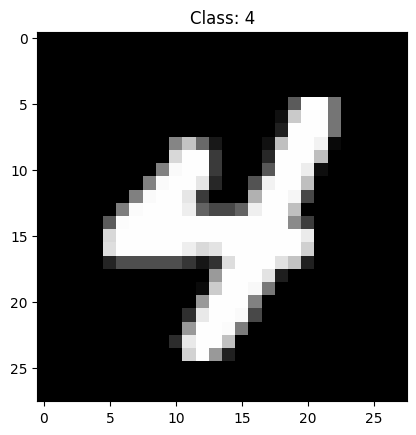

In [ ]:
# Randomly checking the data
idx = np.random.randint(0, digits_data.shape[0])
plt.imshow(digits_data[idx], cmap='gray')
plt.title('Class: ' + str(digits_labels[idx]))

<Axes: xlabel='Labels', ylabel='count'>

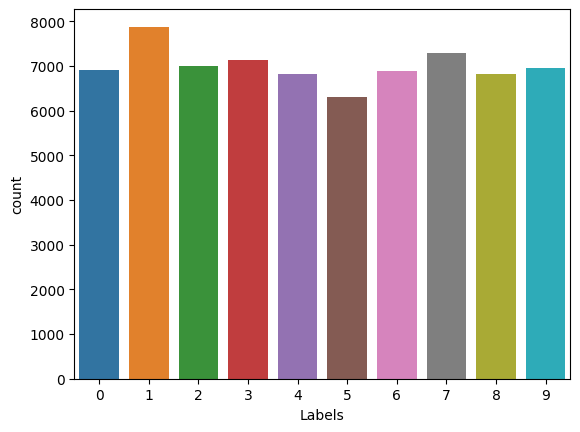

In [ ]:
# Check data distribution
df_labels = pd.DataFrame(digits_labels, columns=['Labels'])
sns.countplot(df_labels, x='Labels')

## **Load Kaggle A-Z**

In [ ]:
!wget https://iaexpert.academy/arquivos/alfabeto_A-Z.zip

--2023-12-19 15:33:06--  https://iaexpert.academy/arquivos/alfabeto_A-Z.zip
Resolving iaexpert.academy (iaexpert.academy)... 162.159.134.42
Connecting to iaexpert.academy (iaexpert.academy)|162.159.134.42|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 193643888 (185M) [application/zip]
Saving to: ‘alfabeto_A-Z.zip’

alfabeto_A-Z.zip    100%[===================>] 184.67M   140MB/s    in 1.3s    

2023-12-19 15:33:08 (140 MB/s) - ‘alfabeto_A-Z.zip’ saved [193643888/193643888]



In [ ]:
# Extract zip file
zip_object = zipfile.ZipFile(file = 'alfabeto_A-Z.zip', mode = 'r')
zip_object.extractall('./')
zip_object.close()

In [ ]:
dataset_az = pd.read_csv('A_Z Handwritten Data.csv').astype('float32')
dataset_az

,0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,...,0.639,0.640,0.641,0.642,0.643,0.644,0.645,0.646,0.647,0.648
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372445,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372446,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372447,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372448,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Get pixel data only
alphabet_data = dataset_az.drop('0', axis=1)
# Get labels only
alphabet_labels = dataset_az['0']

In [ ]:
# Check shape data
alphabet_data.shape, alphabet_labels.shape

((372450, 784), (372450,))

In [ ]:
# Check shape labels
alphabet_labels.shape

(372450,)

In [ ]:
# Reshape pixel data to 28*28
alphabet_data = np.reshape(alphabet_data.values, (alphabet_data.shape[0], 28, 28))
# Check the result by its shape
alphabet_data.shape

(372450, 28, 28)

Text(0.5, 1.0, 'Class: 20.0')

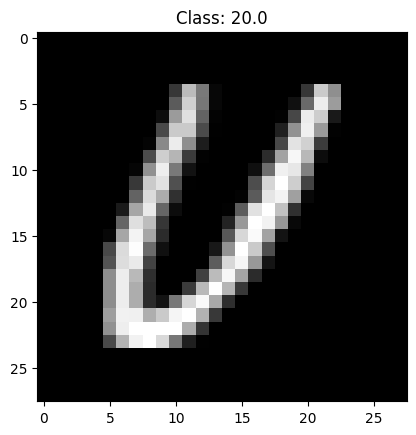

In [ ]:
# Randomly checking A-Z dataset
index = np.random.randint(0, alphabet_data.shape[0])
plt.imshow(alphabet_data[index], cmap = 'gray')
plt.title('Class: ' + str(alphabet_labels[index]))

<Axes: xlabel='Labels', ylabel='count'>

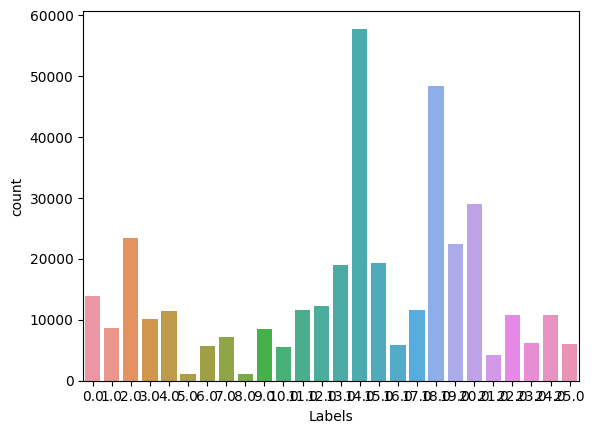

In [ ]:
# Check data distribution
df_az_labels = pd.DataFrame({
    'Labels': alphabet_labels.values
})
sns.countplot(df_az_labels, x='Labels')

# **Combine Dataset (MNIST + Kaggel A-Z)**

In [ ]:
# Check unique value from digits_labels
np.unique(digits_labels)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8)

In [ ]:
# Check unique value from alphabet_labels
np.unique(alphabet_labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.],
      dtype=float32)

In [ ]:
# We already know that digits labels containt labels from 0-9 (10 labels)
# We also know that alphabet labels start from 0-25 which represent A-Z
# If we want to combine them, the A-Z labels should continuing the digits label

alphabet_labels += 10

In [ ]:
# check alphabet labels again
np.unique(alphabet_labels)

array([10., 11., 12., 13., 14., 15., 16., 17., 18., 19., 20., 21., 22.,
       23., 24., 25., 26., 27., 28., 29., 30., 31., 32., 33., 34., 35.],
      dtype=float32)

In [ ]:
# Combine both of them
data = np.vstack([alphabet_data, digits_data])
labels = np.hstack([alphabet_labels, digits_labels])

In [ ]:
# Check the shape
data.shape, labels.shape

((442450, 28, 28), (442450,))

In [ ]:
# Check labels
np.unique(labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35.], dtype=float32)

In [ ]:
# Convert data to float32
data = np.array(data, dtype = 'float32')

In [ ]:
# Since Convolutional need 3d data (including depth)
# and our images only in 2d data (because in grayscale format)
# we need to add "the depth" to the data
data = np.expand_dims(data, axis=-1)

# check shape
data.shape

(442450, 28, 28, 1)

## Preprocessing

In [ ]:
# Normalize data
data /= 255.0

In [ ]:
# Check range value of data
data[0].min(), data[0].max()

(0.0, 1.0)

In [ ]:
# Enconde the labels
# LabelBinarizer similar with OneHotEncoder
le = LabelBinarizer()
labels = le.fit_transform(labels)

In [ ]:
# Check labels shape
labels.shape

(442450, 36)

Text(0.5, 1.0, '[0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]')

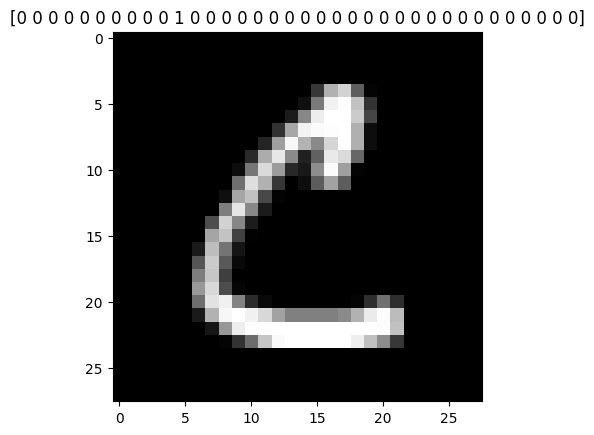

In [ ]:
# Check data with label binarizer's label
plt.imshow(data[30000].reshape(28,28), cmap='gray')
plt.title(str(labels[0]))

In [ ]:
# Since our data is not balance, we will handle it by giving weight for 'small' data

# Check number of data for each labels first
classes_total = labels.sum(axis = 0)
classes_total

array([ 6903,  7877,  6990,  7141,  6824,  6313,  6876,  7293,  6825,
        6958, 13869,  8668, 23409, 10134, 11440,  1163,  5762,  7218,
        1120,  8493,  5603, 11586, 12336, 19010, 57825, 19341,  5812,
       11566, 48419, 22495, 29008,  4182, 10784,  6272, 10859,  6076])

In [ ]:
# Check the biggest value of data
classes_total.max()

57825

In [ ]:
# Create a weight for each data
classes_weights = {}
for i in range(0, len(classes_total)):
  #print(i)
  classes_weights[i] = classes_total.max() / classes_total[i]

# Check the weight for each data
classes_weights

{0: 8.376792698826597,
 1: 7.340992763742541,
 2: 8.272532188841202,
 3: 8.097605377398123,
 4: 8.473769050410317,
 5: 9.15967052114684,
 6: 8.409685863874346,
 7: 7.928835870012341,
 8: 8.472527472527473,
 9: 8.310577752227651,
 10: 4.169370538611291,
 11: 6.671089063221043,
 12: 2.4702037677816224,
 13: 5.7060390763765545,
 14: 5.0546328671328675,
 15: 49.72055030094583,
 16: 10.035577924331829,
 17: 8.011221945137157,
 18: 51.629464285714285,
 19: 6.808548216178029,
 20: 10.320364090665715,
 21: 4.990937338166753,
 22: 4.6875,
 23: 3.0418200946870066,
 24: 1.0,
 25: 2.989762680316426,
 26: 9.94924294562973,
 27: 4.999567698426422,
 28: 1.1942625828703608,
 29: 2.5705712380529007,
 30: 1.993415609487038,
 31: 13.827116212338593,
 32: 5.362110534124629,
 33: 9.21954719387755,
 34: 5.3250759738465785,
 35: 9.51695194206715}

## Split Data to Train and Test

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size = 0.2, random_state = 1, stratify = labels)

## Create Data Augmentation

In [ ]:
# Import library
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
augmentation = ImageDataGenerator(rotation_range = 10, zoom_range=0.05, width_shift_range=0.1,
                                  height_shift_range=0.1, horizontal_flip = False)

## Build CNN Model

In [ ]:
# Import library
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Flatten, Dense
from tensorflow.keras.callbacks import ModelCheckpoint

In [ ]:
# Build the network
network = Sequential()

network.add(Conv2D(filters = 32, kernel_size=(3,3), activation='relu', input_shape=(28,28,1)))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 64, kernel_size=(3,3), activation='relu', padding='same'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 128, kernel_size=(3,3), activation='relu', padding='valid'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Flatten())

network.add(Dense(64, activation = 'relu'))
network.add(Dense(128, activation = 'relu'))

# output
network.add(Dense(36, activation='softmax'))

network.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

In [ ]:
# Check network summary
network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 2, 2, 128)         0

In [ ]:
# Create actual labels
name_labels = '0123456789'
name_labels += 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
name_labels = [l for l in name_labels]

# Check actual label
print(name_labels)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


In [ ]:
import joblib

joblib.dump(name_labels, "labels.pkl")

['labels.pkl']

In [ ]:
a = joblib.load("labels.pkl")
print(a)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


## Train model

In [ ]:
# Set model name, epoch, and batch size
file_model = 'custom_ocr.model'
epochs = 20
batch_size = 128

In [ ]:
# Setup checkpoint
checkpointer = ModelCheckpoint(file_model, monitor = 'val_loss', verbose = 1, save_best_only=True)

In [ ]:
# Fit the model
history = network.fit(augmentation.flow(X_train, y_train, batch_size=batch_size),
                      validation_data = (X_test, y_test),
                      steps_per_epoch = len(X_train) // batch_size, epochs=epochs,
                      class_weight = classes_weights, verbose=1, callbacks=[checkpointer])

Epoch 1/20
2765/2765 [==============================] - ETA: 0s - loss: 0.7322 - accuracy: 0.9212
Epoch 1: val_loss did not improve from 0.15847
2765/2765 [==============================] - 128s 46ms/step - loss: 0.7322 - accuracy: 0.9212 - val_loss: 0.3349 - val_accuracy: 0.8652
Epoch 2/20
2765/2765 [==============================] - ETA: 0s - loss: 0.6656 - accuracy: 0.9271
Epoch 2: val_loss did not improve from 0.15847
2765/2765 [==============================] - 117s 42ms/step - loss: 0.6656 - accuracy: 0.9271 - val_loss: 0.2942 - val_accuracy: 0.8777
Epoch 3/20
2764/2765 [============================>.] - ETA: 0s - loss: 0.6284 - accuracy: 0.9309
Epoch 3: val_loss did not improve from 0.15847
2765/2765 [==============================] - 123s 44ms/step - loss: 0.6284 - accuracy: 0.9309 - val_loss: 0.2199 - val_accuracy: 0.9133
Epoch 4/20
2764/2765 [============================>.] - ETA: 0s - loss: 0.5846 - accuracy: 0.9337
Epoch 4: val_loss did not improve from 0.15847
2765/2765 [=

# **Evaluate Model**

In [ ]:
# The result will show in colab directory
save_path ='/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2'
network.save(save_path)

In [ ]:
import re
import cv2
import random
import os
from PIL import Image
import subprocess
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model
from imutils.contours import sort_contours

In [ ]:
save_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2'
load_network = load_model(save_path)

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# make a prediction
predictions = load_network.predict(X_test, batch_size=batch_size)

692/692 [==============================] - 2s 2ms/step


In [ ]:
# Check prediction for data-0
# You will get the probability for each label
# The highest one is the prediction
predictions[10]

array([4.0037221e-06, 3.0157945e-09, 2.4210669e-07, 3.0696576e-06,
       1.9241732e-08, 1.3857102e-02, 8.2235892e-05, 5.2568333e-10,
       9.4921853e-07, 9.1817392e-06, 5.6858274e-09, 2.5745019e-06,
       1.2202955e-06, 1.4774564e-06, 3.6689534e-09, 2.1693900e-11,
       4.3895820e-04, 2.3574775e-09, 4.3114861e-14, 2.2963273e-05,
       1.1028899e-08, 9.6699496e-06, 1.0813104e-12, 7.5089295e-09,
       1.3626441e-05, 1.3824483e-07, 1.4152625e-06, 3.8140519e-13,
       9.8554796e-01, 4.0991242e-08, 4.7602788e-07, 4.8843541e-13,
       6.6824219e-07, 2.7580657e-15, 2.0145653e-06, 3.2952975e-08],
      dtype=float32)

In [ ]:
# Get the actual prediction -> highest probability
np.argmax(predictions[10])


28

In [ ]:
# Check label for 24
name_labels[28]

'S'

In [ ]:
# Check y_test label for 0
y_test[10]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0])

In [ ]:
# check the highest value
np.argmax(y_test[10])

28

In [ ]:
# Check the label of y_test 0
name_labels[np.argmax(y_test[10])]

'S'

In [ ]:
# Evaluate on test data
load_network.evaluate(X_test, y_test)

2766/2766 [==============================] - 8s 3ms/step - loss: 0.1228 - accuracy: 0.9628


[0.12278632819652557, 0.9628432393074036]

In [ ]:
# Print Classification Report
print(classification_report(y_test.argmax(axis=1), predictions.argmax(axis=1), target_names = name_labels))

              precision    recall  f1-score   support

           0       0.62      0.42      0.50      1381
           1       0.98      0.99      0.98      1575
           2       0.93      0.96      0.94      1398
           3       0.98      0.98      0.98      1428
           4       0.92      0.97      0.94      1365
           5       0.81      0.90      0.85      1263
           6       0.96      0.96      0.96      1375
           7       0.96      0.99      0.98      1459
           8       0.97      0.99      0.98      1365
           9       0.99      0.95      0.97      1392
           A       1.00      0.98      0.99      2774
           B       0.98      0.99      0.98      1734
           C       0.99      0.99      0.99      4682
           D       0.83      0.99      0.90      2027
           E       1.00      0.97      0.98      2288
           F       0.91      1.00      0.95       233
           G       0.95      0.96      0.95      1152
           H       0.95    

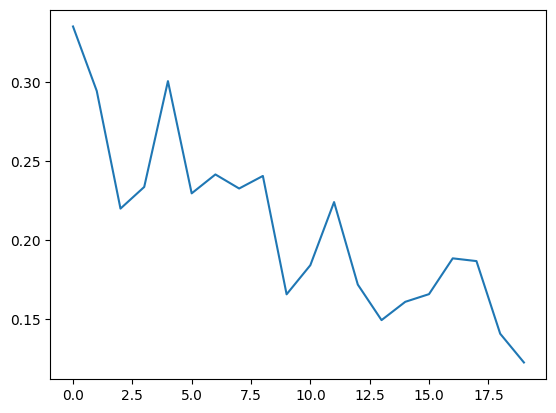

In [ ]:
# Visualize loss value for each epoch
plt.plot(history.history['val_loss'])

In [ ]:
# You can also check the another metrics
history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

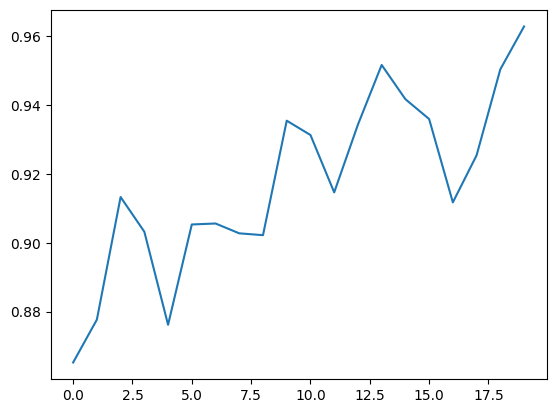

In [ ]:
# Check the model performance by validation accuracy
plt.plot(history.history['val_accuracy'])

# **Character Recognition KTM**

#### **1. Import Library**

In [1]:
import os
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
from PIL import Image
from IPython.display import display



#### **2. Load data dari Google Drive**

In [3]:
folder_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2'
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]


#### **3. Menampilkan Semua gambar**

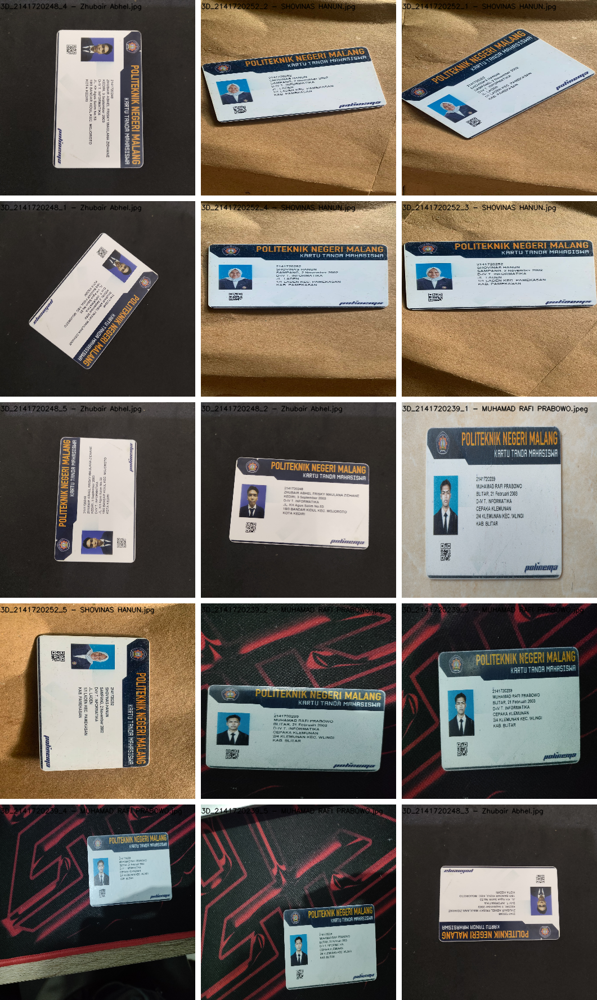

In [4]:
# Menentukan jumlah kolom dan baris untuk grid
num_cols = 3
num_rows = 5

# Menghitung ukuran gambar kecil sebagai 30% dari ukuran gambar utama
composite_height, composite_width, _ = np.shape(cv2.imread(os.path.join(folder_path, image_files[0])))
small_img_size = (int(0.1 * composite_width), int(0.1 * composite_height))

spacing = 10  # Jarak antar gambar

# Menginisialisasi gambar komposit dengan latar belakang putih dan jarak antar gambar
composite_image = np.ones((small_img_size[1] * num_rows + (num_rows - 1) * spacing,
                           small_img_size[0] * num_cols + (num_cols - 1) * spacing, 3), dtype=np.uint8) * 255

font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 0.4
font_thickness = 1

for i, image_file in enumerate(image_files):
    image_path = os.path.join(folder_path, image_file)
    img = cv2.imread(image_path)

    # Mengubah ukuran gambar kecil untuk menyesuaikan grid
    small_img = cv2.resize(img, small_img_size)

    # Menentukan posisi baris dan kolom dalam grid
    row = i // num_cols
    col = i % num_cols

    # Menghitung posisi gambar dalam gambar komposit
    y_position = row * (small_img_size[1] + spacing)
    x_position = col * (small_img_size[0] + spacing)

    # Menempatkan gambar ke dalam gambar komposit
    composite_image[y_position:y_position + small_img_size[1], x_position:x_position + small_img_size[0]] = small_img

    # Menambahkan teks (nama file) di atas gambar
    text_position = (x_position, y_position + 15)
    cv2.putText(composite_image, image_file, text_position, font, font_scale, (0, 0, 0), font_thickness, cv2.LINE_AA)

# Menampilkan gambar komposit
cv2_imshow(composite_image)

#### **4. Melakukan Croping Gambar**

###### **Gambar 1**

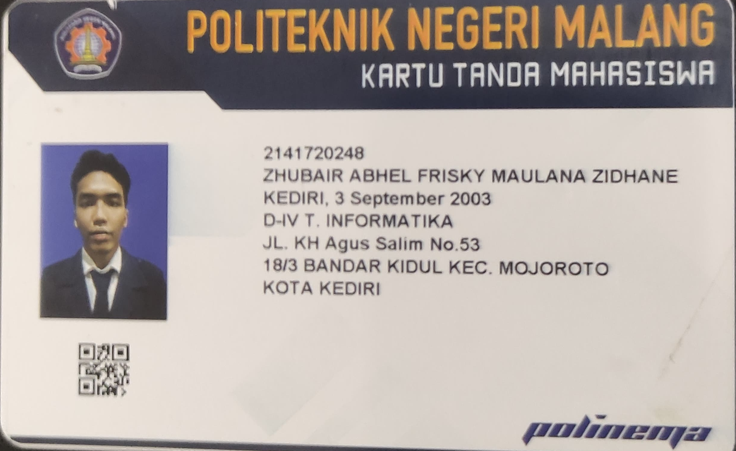

In [5]:
# Crop Gambar 1
img1_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720248_4 - Zhubair Abhel.jpg'

# Load the image using PIL
img_pil = Image.open(img1_path)

# Resize the image to 15%
resize_percentage = 30
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 90

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv1 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 290
bottom_crop = 300
left_crop = 160
right_crop = 145

# Crop the image from the top, bottom, left, and right
cropped_img1 = rotated_img_cv1[top_crop:rotated_img_cv1.shape[0] - bottom_crop, left_crop:rotated_img_cv1.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img1)

###### **Gambar 2**

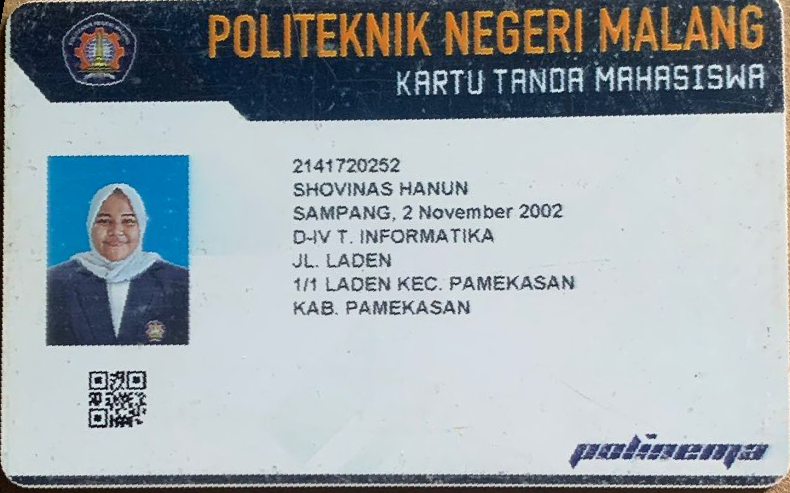

In [6]:
# Crop Gambar 2
img2_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720252_2 - SHOVINAS HANUN.jpg'

# Load the image using PIL
img_pil = Image.open(img2_path)

# Resize the image to 100%
resize_percentage = 100
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = -10

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv2 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)

# Coordinates for cropping (adjust based on your KTP size)
top_crop = 450
bottom_crop = 657
left_crop = 50
right_crop = 60

# Crop the image from the top, bottom, left, and right
cropped_img2 = rotated_img_cv2[top_crop:rotated_img_cv2.shape[0] - bottom_crop, left_crop:rotated_img_cv2.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img2)

###### **Gambar 3**

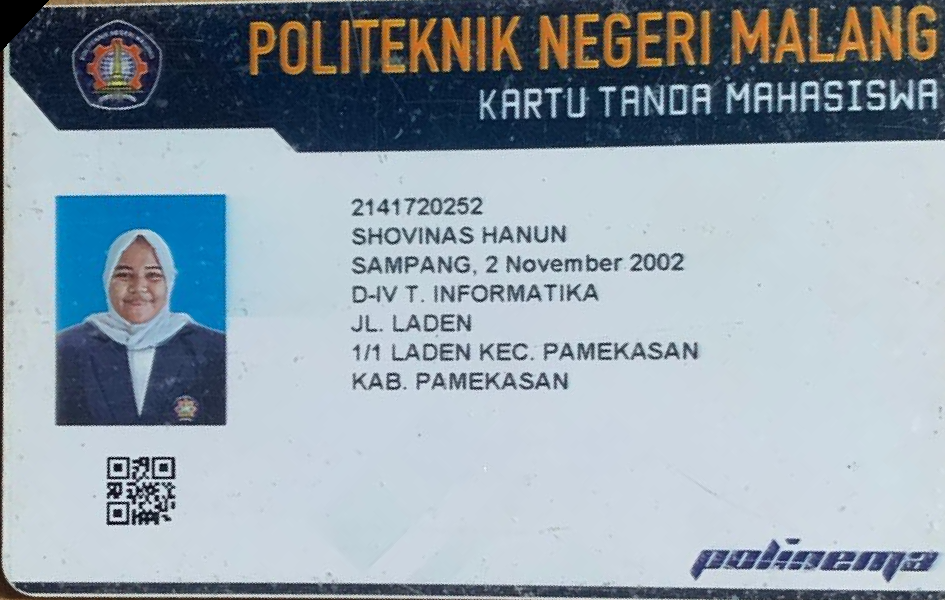

In [7]:
# Crop Gambar 3
img3_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720252_1 - SHOVINAS HANUN.jpg'

# Load the image using PIL
img_pil = Image.open(img3_path)

# Resize the image to 120%
resize_percentage = 120
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = -43

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv3 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 550
bottom_crop = 770
left_crop = 135
right_crop = 0

# Crop the image from the top, bottom, left, and right
cropped_img3 = rotated_img_cv3[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img3)

###### **Gambar 4**

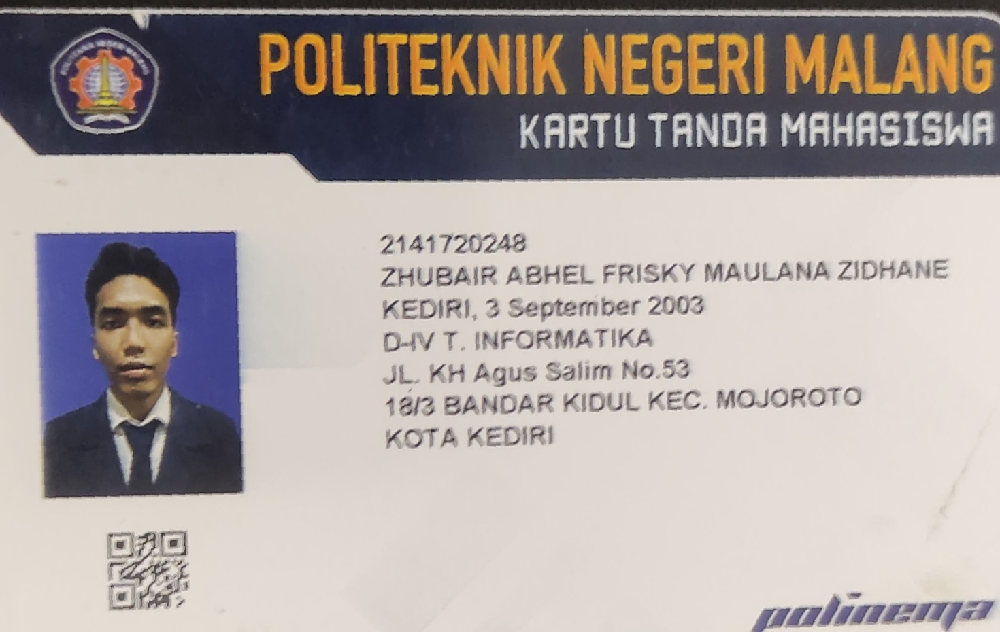

In [8]:
# Crop Gambar 4
img4_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720248_5 - Zhubair Abhel.jpg'

# Load the image using PIL
img_pil = Image.open(img4_path)

# Resize the image to 100%
resize_percentage = 70
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 273

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv2 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)

# Coordinates for cropping (adjust based on your KTP size)
top_crop = 700
bottom_crop = 800
left_crop = 480
right_crop = 480

# Crop the image from the top, bottom, left, and right
cropped_img4 = rotated_img_cv2[top_crop:rotated_img_cv2.shape[0] - bottom_crop, left_crop:rotated_img_cv2.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img4)

###### **Gambar 5**

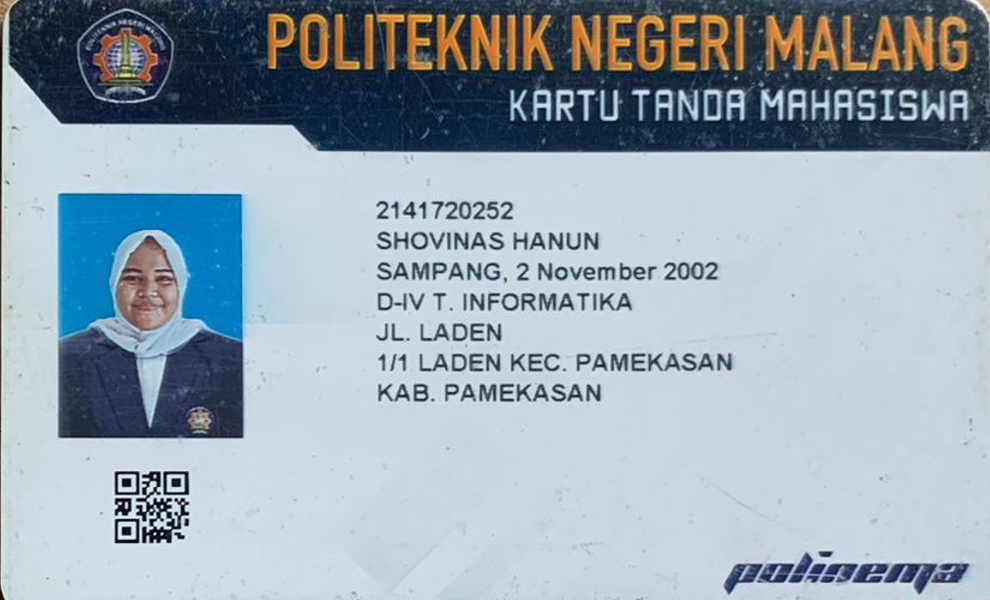

In [9]:
# Crop Gambar 5
img5_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720252_4 - SHOVINAS HANUN.jpg'

# Load the image using PIL
img_pil = Image.open(img5_path)

# Resize the image to 120%
resize_percentage = 120
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 0

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv5 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 430
bottom_crop = 890
left_crop = 40
right_crop = 50

# Crop the image from the top, bottom, left, and right
cropped_img5 = rotated_img_cv5[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img5)

###### **Gambar 6**

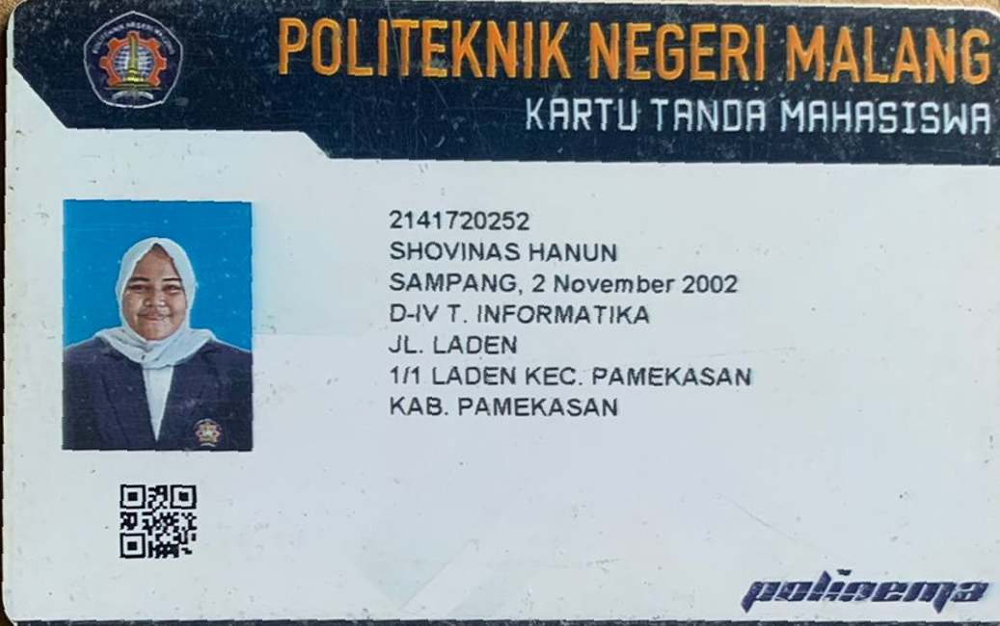

In [10]:
# Crop Gambar 6
img6_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720252_3 - SHOVINAS HANUN.jpg'

# Load the image using PIL
img_pil = Image.open(img6_path)

# Resize the image to 120%
resize_percentage = 120
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = -2

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv6 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 390
bottom_crop = 880
left_crop = 23
right_crop = 20

# Crop the image from the top, bottom, left, and right
cropped_img6 = rotated_img_cv6[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img6)

###### **Gambar 7**

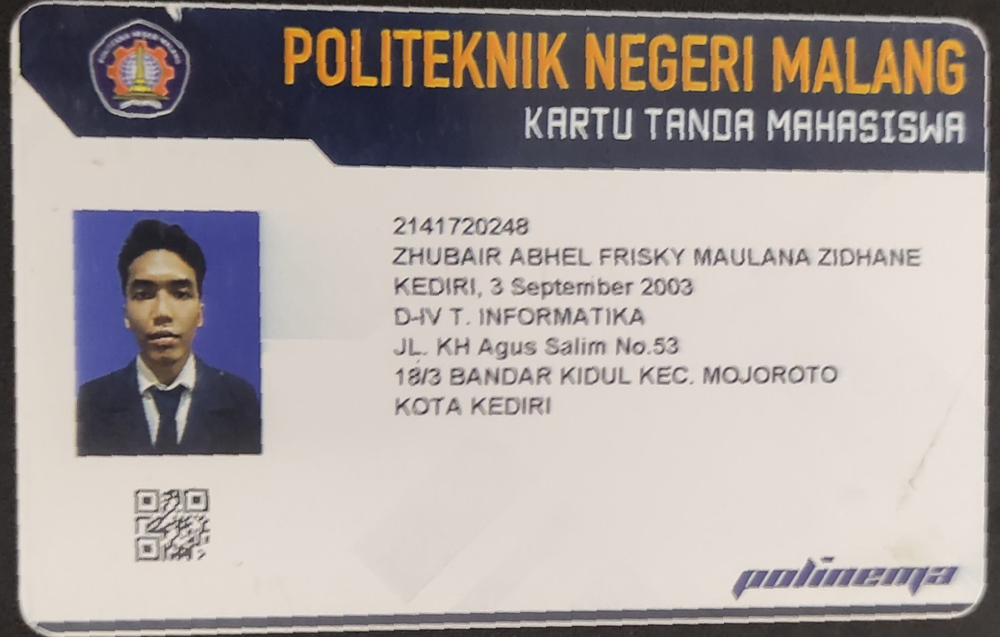

In [16]:
# Crop Gambar 7
img7_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720248_5 - Zhubair Abhel.jpg'

# Load the image using PIL
img_pil = Image.open(img7_path)

# Resize the image to 120%
resize_percentage = 50
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 272

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv7 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 500
bottom_crop = 700
left_crop = 300
right_crop = -350

# Crop the image from the top, bottom, left, and right
cropped_img7 = rotated_img_cv7[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]

# Display the rotated image using OpenCV
cv2_imshow(cropped_img7)

###### **Gambar 8**

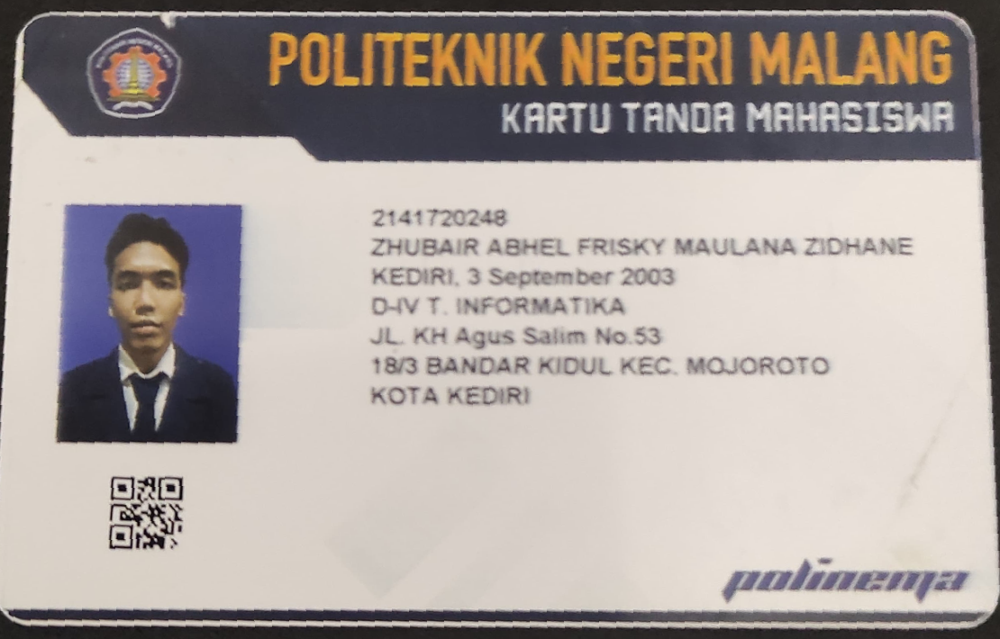

In [17]:
# Crop Gambar 8
img8_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720248_2 - Zhubair Abhel.jpg'

# Load the image using PIL
img_pil = Image.open(img8_path)

# Resize the image to 120%
resize_percentage = 45
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 3

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv8 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 450
bottom_crop = 760
left_crop = 250
right_crop = -280

# Crop the image from the top, bottom, left, and right
cropped_img8 = rotated_img_cv8[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]

# Display the rotated image using OpenCV
cv2_imshow(cropped_img8)

###### **Gambar 9**

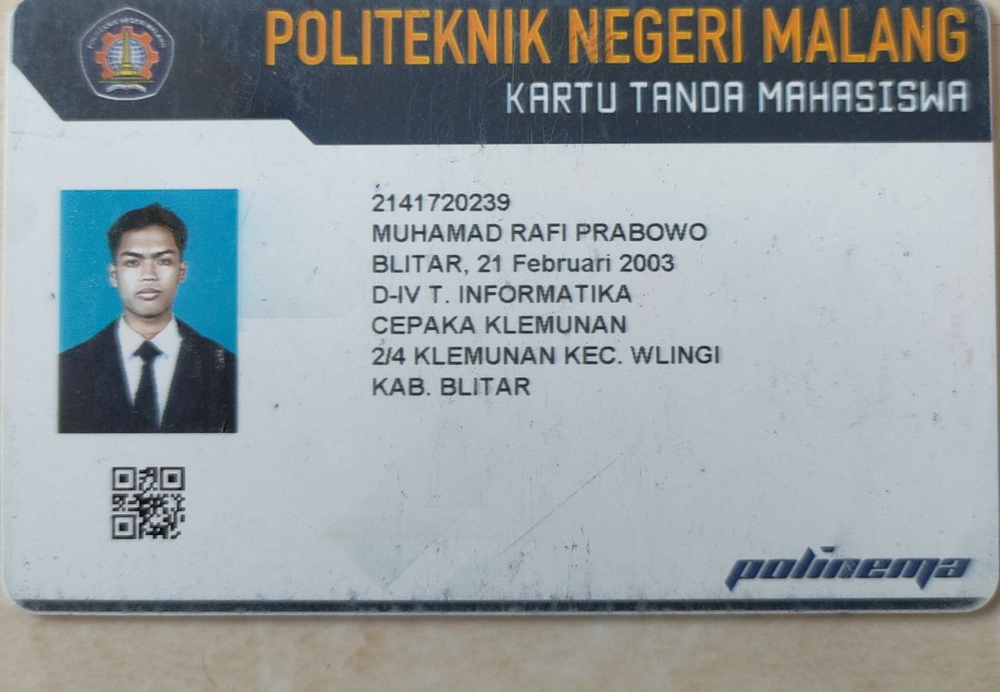

In [137]:
# Crop Gambar 9
img9_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720239_1 - MUHAMAD RAFI PRABOWO.jpeg'

# Load the image using PIL
img_pil = Image.open(img9_path)

# Resize the image to 120%
resize_percentage = 45
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 0

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv9 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 130
bottom_crop = -200
left_crop = 200
right_crop = -265

# Crop the image from the top, bottom, left, and right
cropped_img9 = rotated_img_cv9[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]

# Display the rotated image using OpenCV
cv2_imshow(cropped_img9)

###### **Gambar 10**

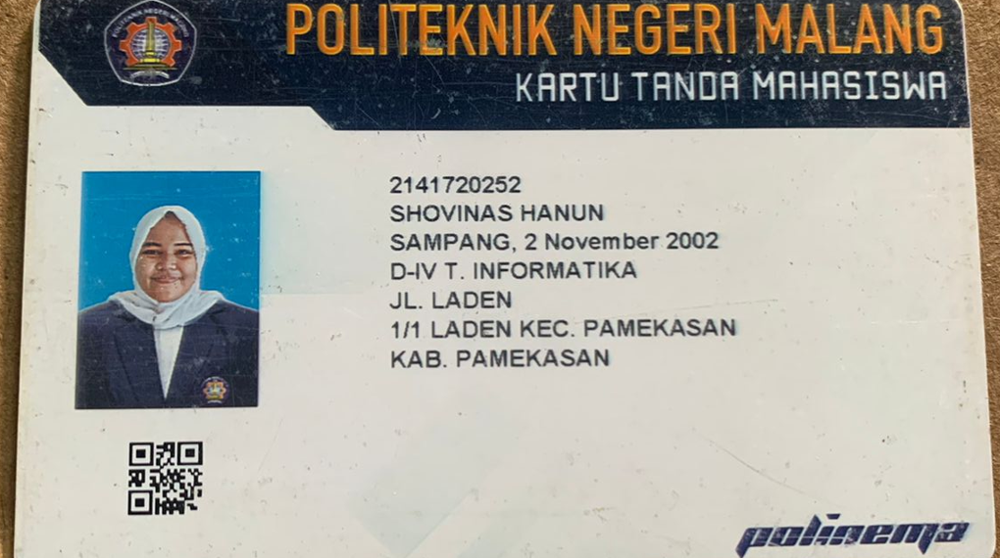

In [138]:
# Crop Gambar 10
img10_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720252_5 - SHOVINAS HANUN.jpg'

# Load the image using PIL
img_pil = Image.open(img10_path)

# Resize the image to 120%
resize_percentage = 90
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 90

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv10 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 450
bottom_crop = 900
left_crop = 40
right_crop = 20

# Crop the image from the top, bottom, left, and right
cropped_img10 = rotated_img_cv10[top_crop:rotated_img_cv3.shape[0] - bottom_crop, left_crop:rotated_img_cv3.shape[1] - right_crop]

# Display the rotated image using OpenCV
cv2_imshow(cropped_img10)

###### **Gambar 11**

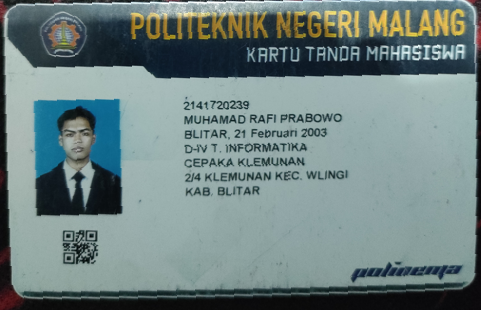

In [20]:
# Crop Gambar 11
img11_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720239_2 - MUHAMAD RAFI PRABOWO.jpg'

# Load the image using PIL
img_pil = Image.open(img11_path)

# Resize the image to 15%
resize_percentage = 15
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 93

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv11 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 210
bottom_crop = 350
left_crop = 100
right_crop = 460

# Crop the image from the top, bottom, left, and right
cropped_img11 = rotated_img_cv11[top_crop:rotated_img_cv1.shape[0] - bottom_crop, left_crop:rotated_img_cv1.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img11)

###### **Gambar 12**

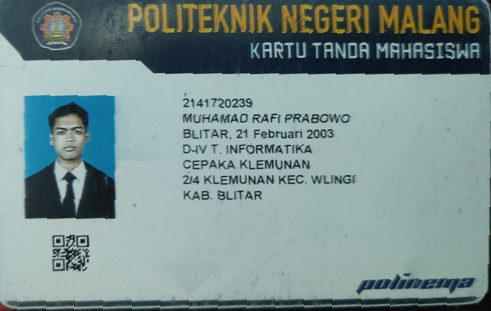

In [21]:
# Crop Gambar 12
img12_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720239_3 - MUHAMAD RAFI PRABOWO.jpg'

# Load the image using PIL
img_pil = Image.open(img12_path)

# Resize the image to 15%
resize_percentage = 15
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 178

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv12 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 130
bottom_crop = 600
left_crop = 140
right_crop = 410

# Crop the image from the top, bottom, left, and right
cropped_img12 = rotated_img_cv12[top_crop:rotated_img_cv1.shape[0] - bottom_crop, left_crop:rotated_img_cv1.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img12)

###### **Gambar 13**

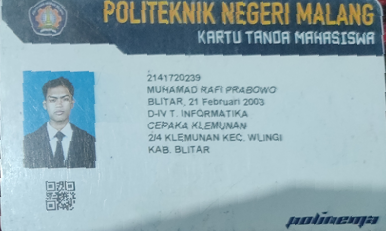

In [41]:
# Crop Gambar 13
img13_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720239_4 - MUHAMAD RAFI PRABOWO.jpg'

# Load the image using PIL
img_pil = Image.open(img13_path)

# Resize the image to 30%
resize_percentage = 20
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 177

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv13 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 120
bottom_crop = 690
left_crop = 425
right_crop = 230

# Crop the image from the top, bottom, left, and right
cropped_img13 = rotated_img_cv13[top_crop:rotated_img_cv1.shape[0] - bottom_crop, left_crop:rotated_img_cv1.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img13)

###### **Gambar 14**

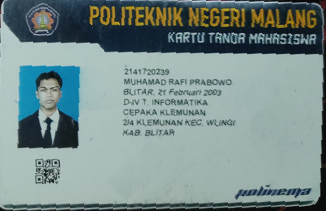

In [118]:
# Crop Gambar 14
img14_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720239_5 - MUHAMAD RAFI PRABOWO.jpg'

# Load the image using PIL
img_pil = Image.open(img14_path)

# Resize the image to 30%
resize_percentage = 15
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 536

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv14 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 280
bottom_crop = 550
left_crop = 290
right_crop = 425

# Crop the image from the top, bottom, left, and right
cropped_img14 = rotated_img_cv14[top_crop:rotated_img_cv1.shape[0] - bottom_crop, left_crop:rotated_img_cv1.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img14)

###### **Gambar 15**

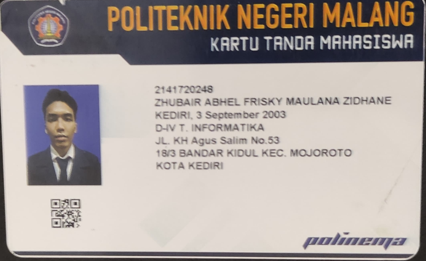

In [132]:
# Crop Gambar 15
img15_path = '/content/drive/MyDrive/Tugas Kuliah /PCVK/UAS_Kelompok 2/3D_2141720248_3 - Zhubair Abhel.jpg'

# Load the image using PIL
img_pil = Image.open(img15_path)

# Resize the image to 30%
resize_percentage = 20
width, height = img_pil.size
new_width = int((resize_percentage / 100) * width)
new_height = int((resize_percentage / 100) * height)
resized_img_pil = img_pil.resize((new_width, new_height))

# Specify the rotation angle (in degrees)
angle = 180

# Rotate the image using PIL
rotated_img_pil = resized_img_pil.rotate(angle)

# Convert PIL image to OpenCV format
rotated_img_cv15 = cv2.cvtColor(np.array(rotated_img_pil), cv2.COLOR_RGB2BGR)


# Coordinates for cropping (adjust based on your KTP size)
top_crop = 215
bottom_crop = 565
left_crop = 135
right_crop = 480

# Crop the image from the top, bottom, left, and right
cropped_img15 = rotated_img_cv15[top_crop:rotated_img_cv1.shape[0] - bottom_crop, left_crop:rotated_img_cv1.shape[1] - right_crop]


# Display the rotated image using OpenCV
cv2_imshow(cropped_img15)

#### **5. Mengabungkan Gambar yang di crop**

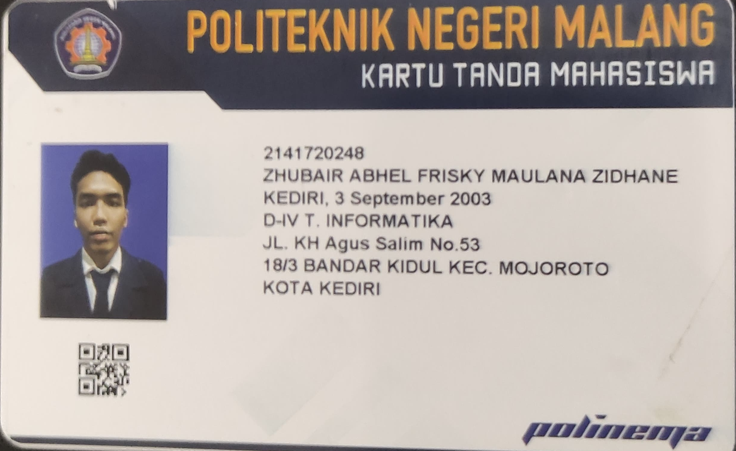

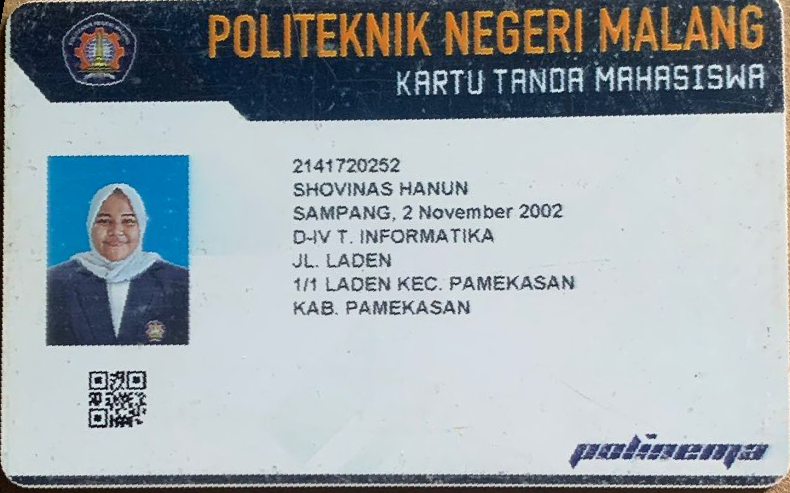

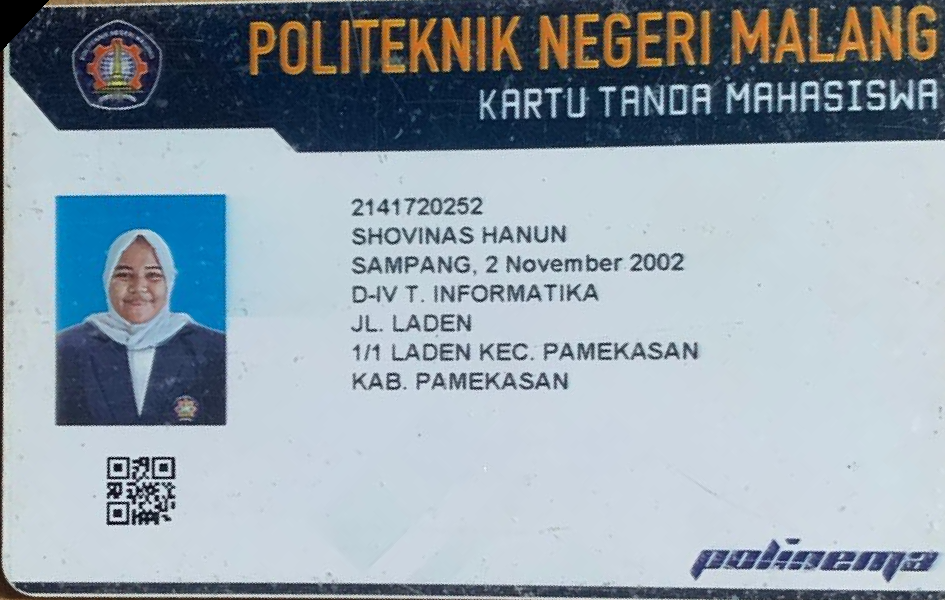

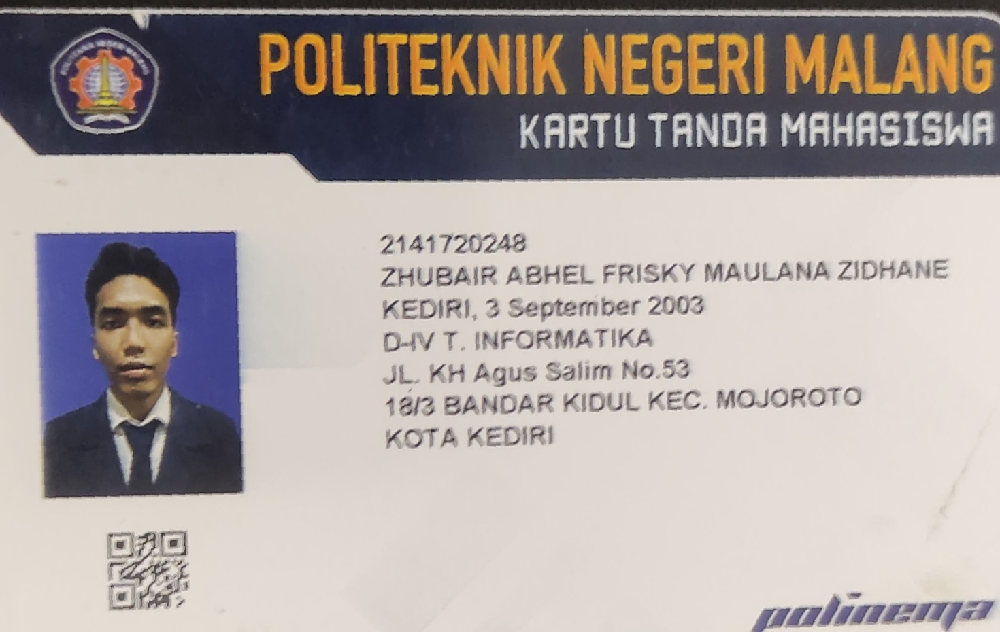

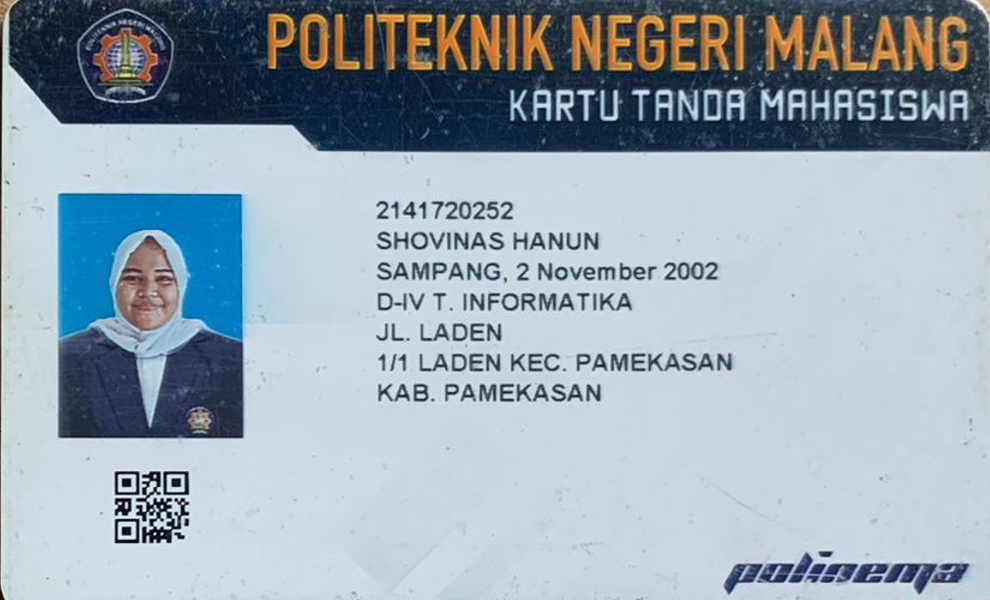

...

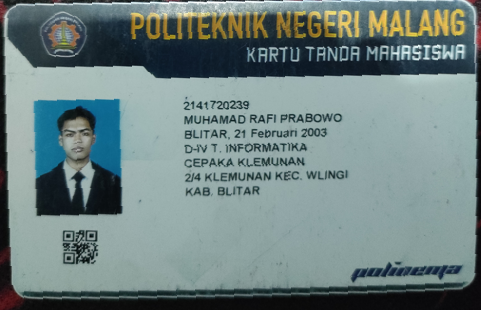

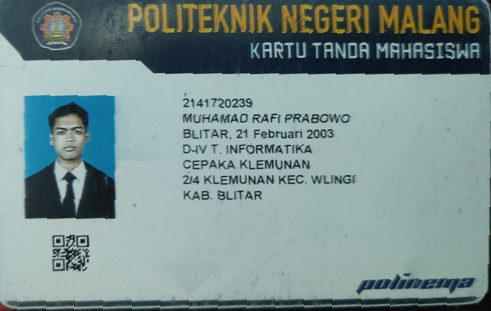

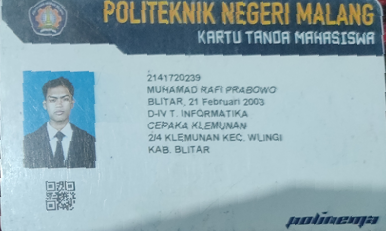

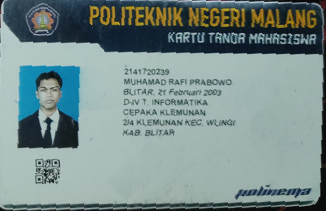

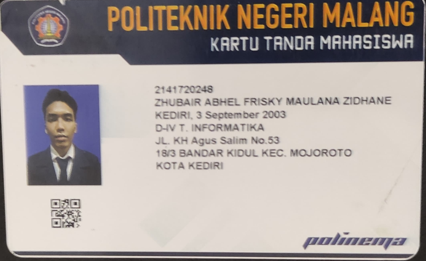

In [141]:
# Store the cropped images in a list
cropped_images = [cropped_img1, cropped_img2, cropped_img3, cropped_img4, cropped_img5, cropped_img6, cropped_img7, cropped_img8,
                  cropped_img9, cropped_img10, cropped_img11, cropped_img12, cropped_img13, cropped_img14, cropped_img15]

# Display each cropped image
for i, img in enumerate(cropped_images):
    cv2_imshow(img)

#### **6. Mengubah ke grayscale, GaussianBlur, Adaptive Thresholding, Dilation, Edge Detecton - canny**



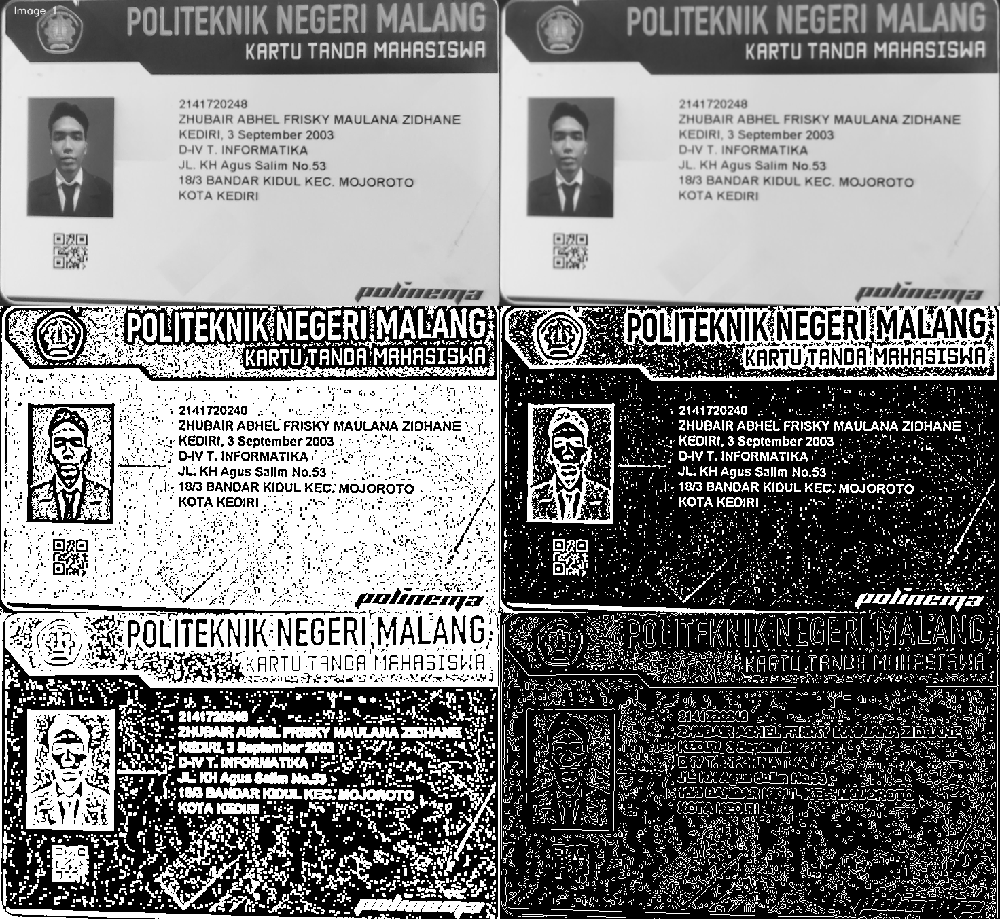

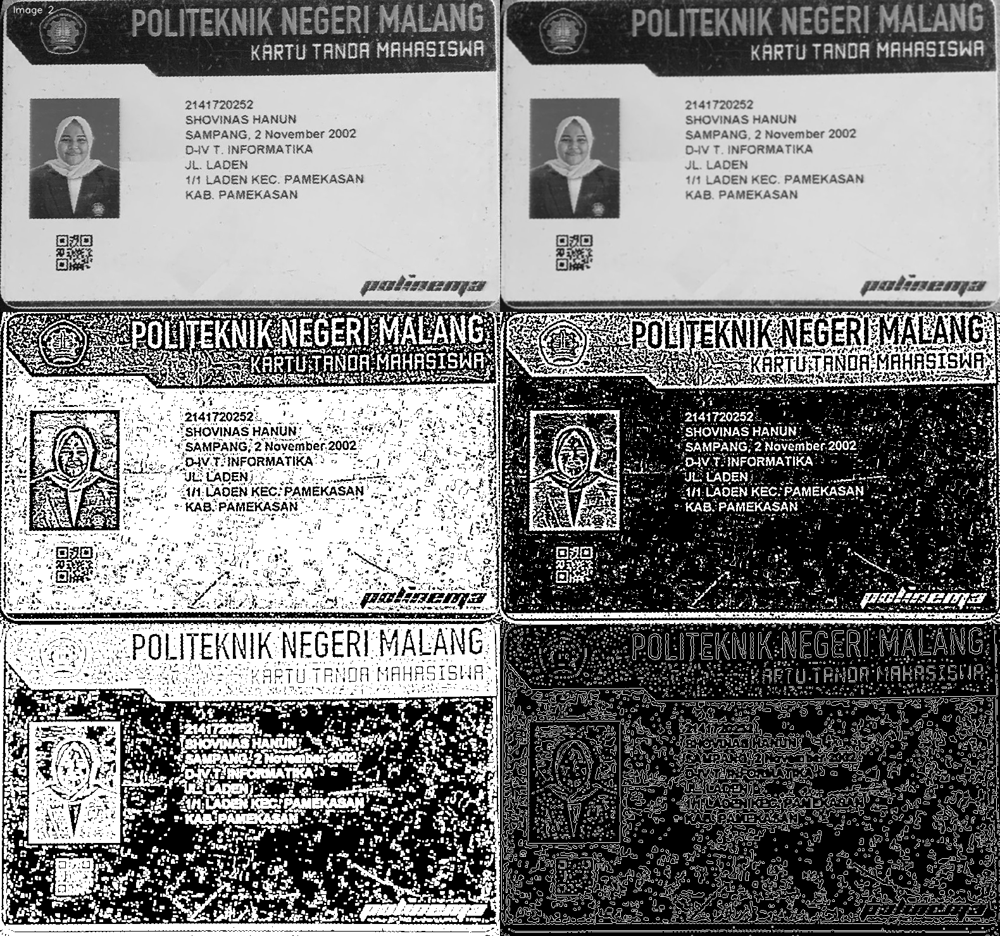

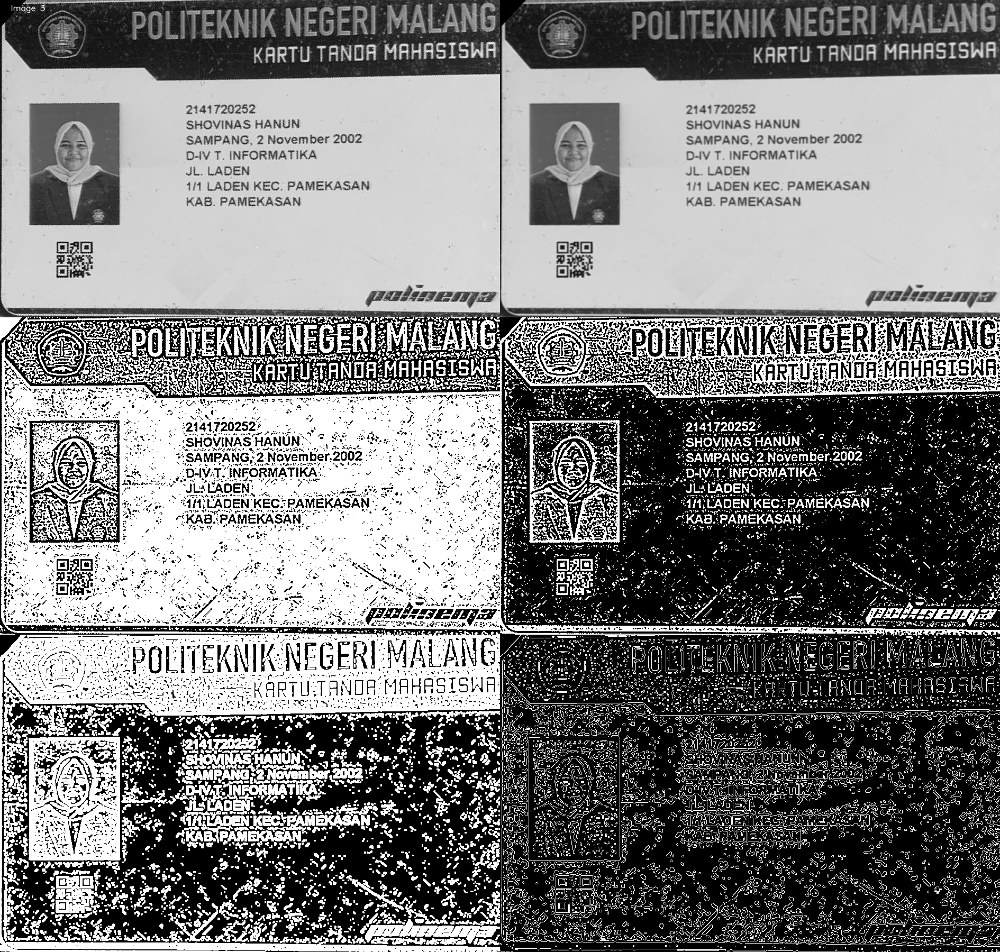

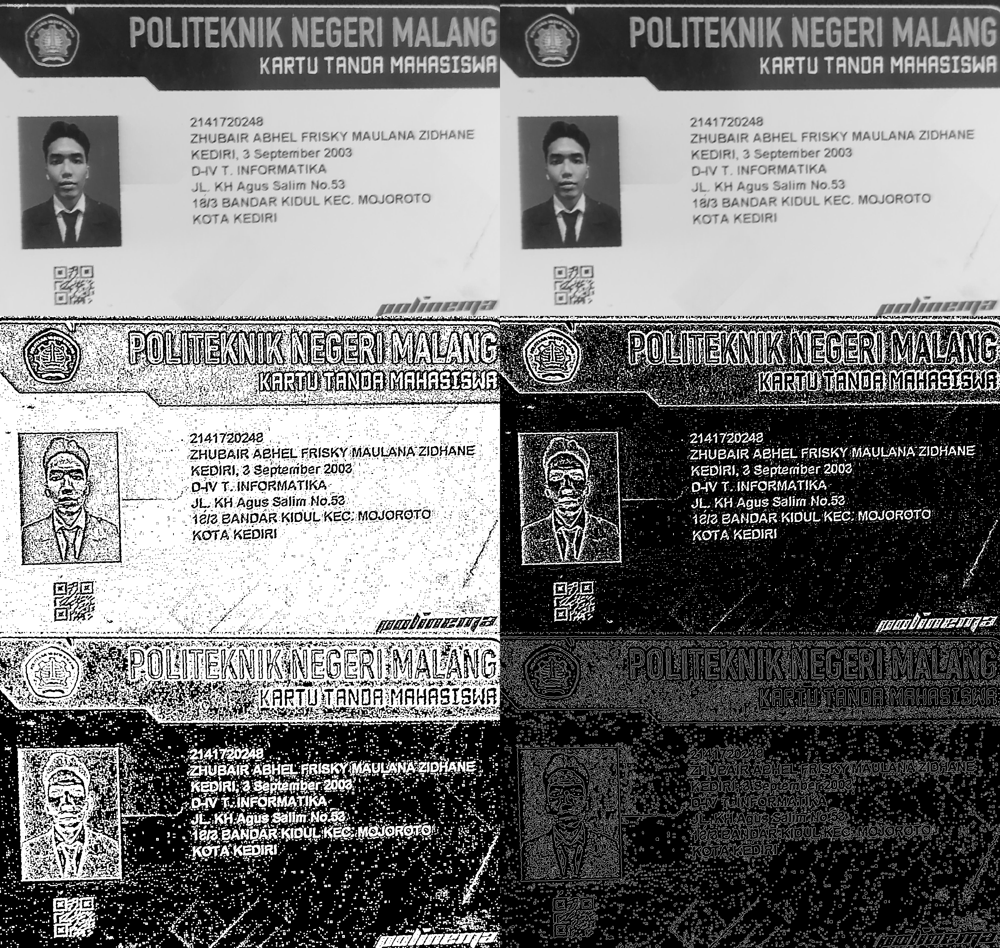

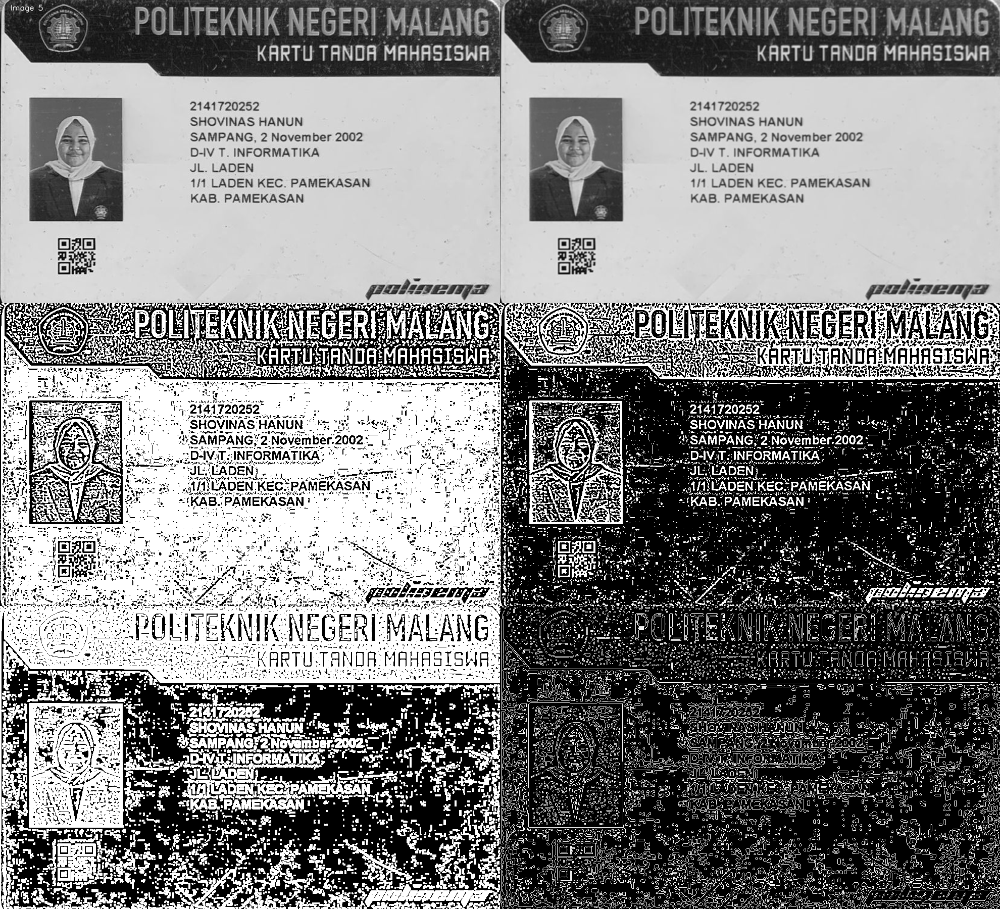

...

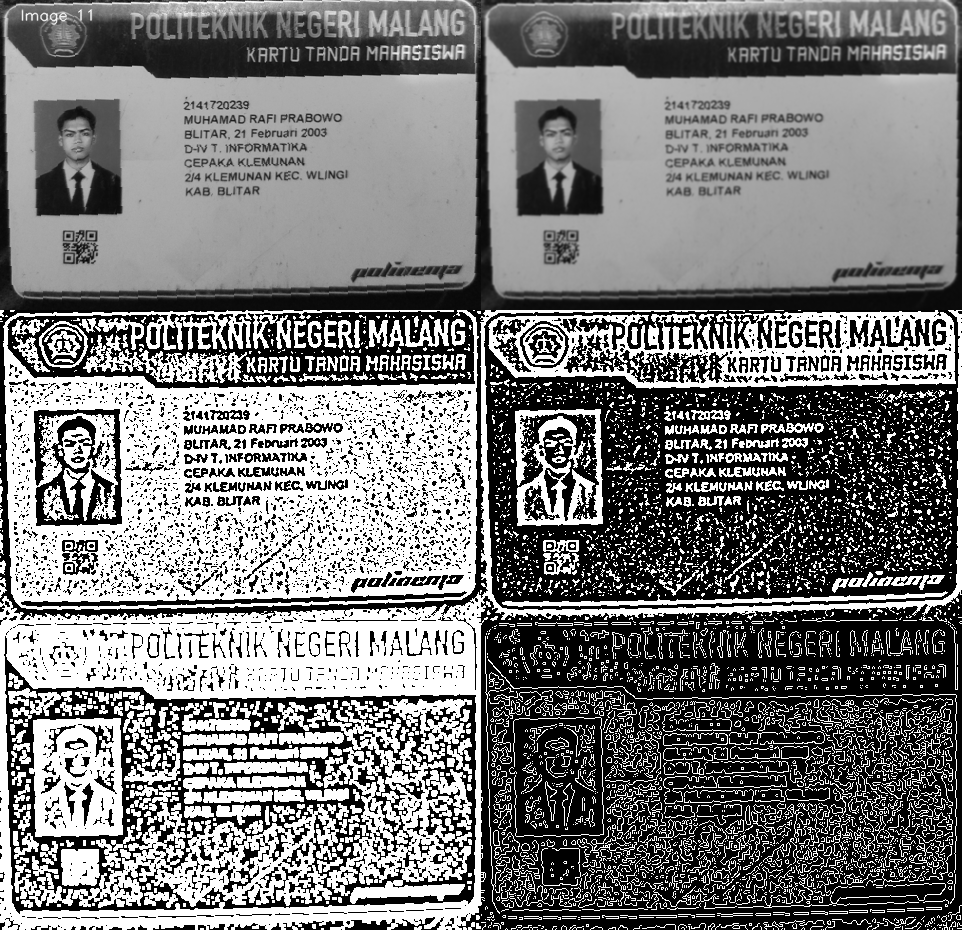

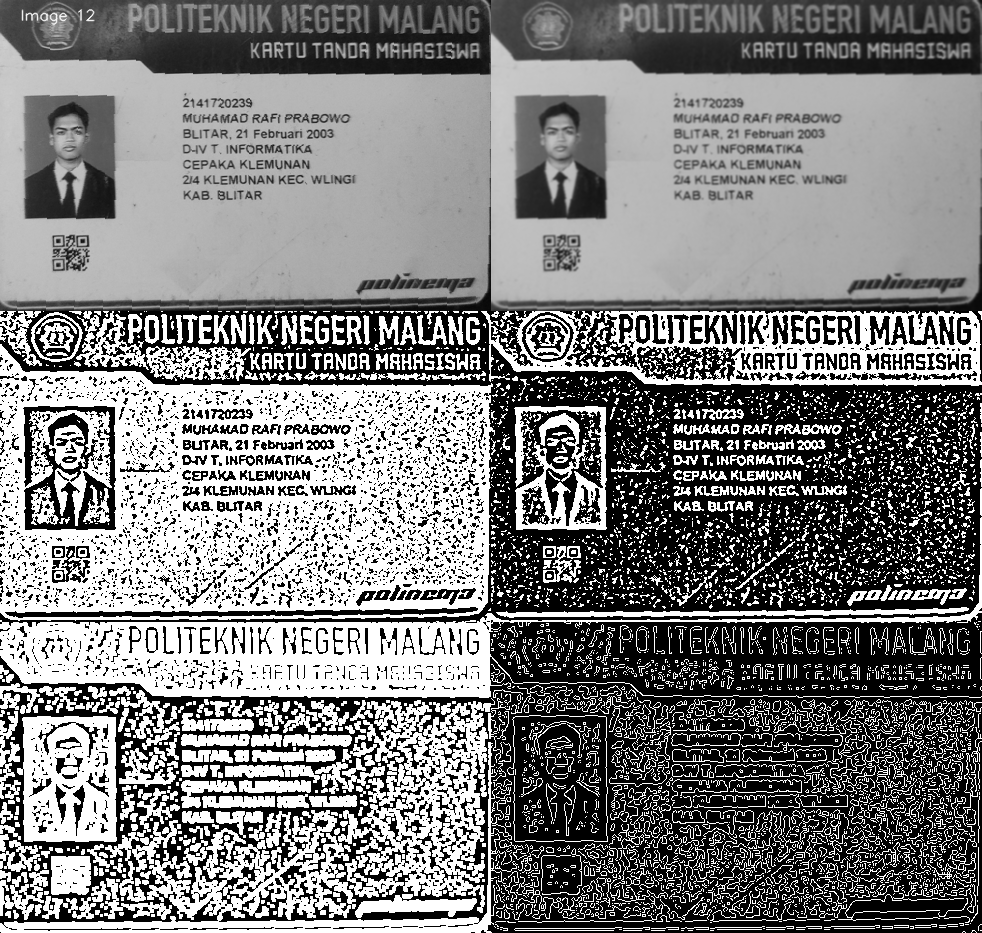

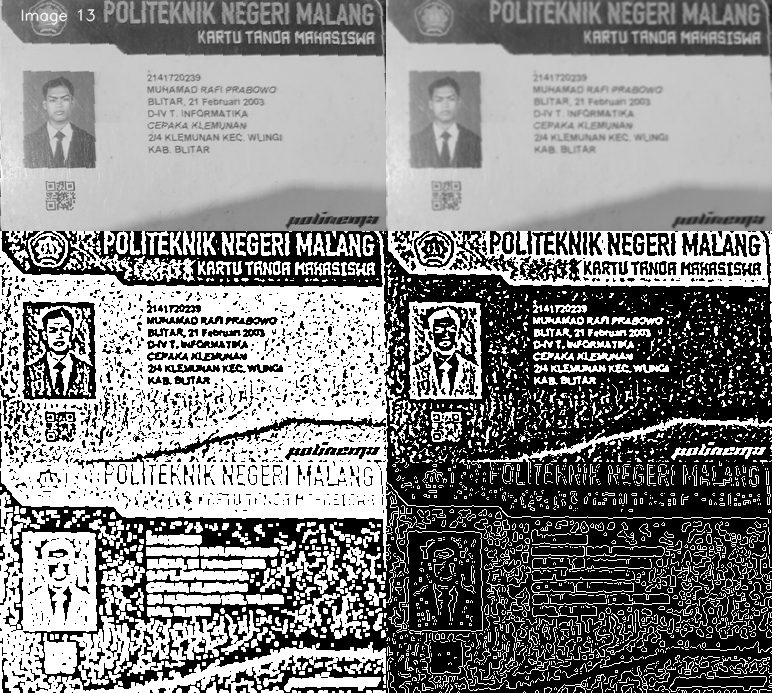

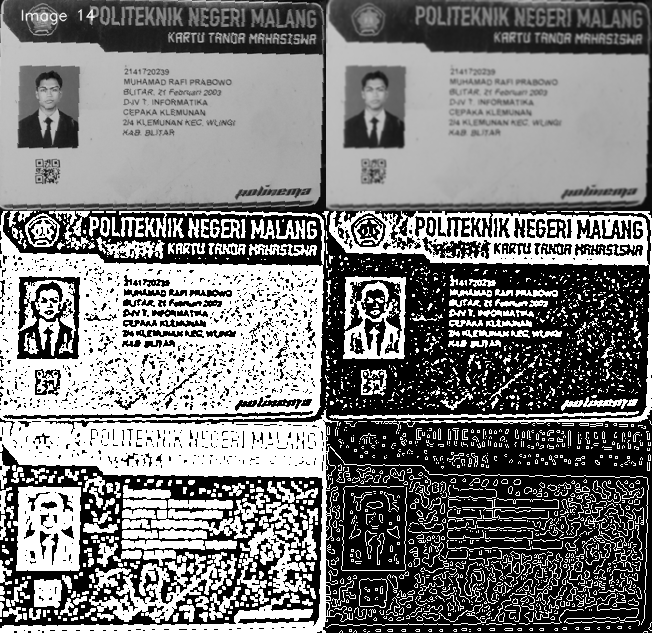

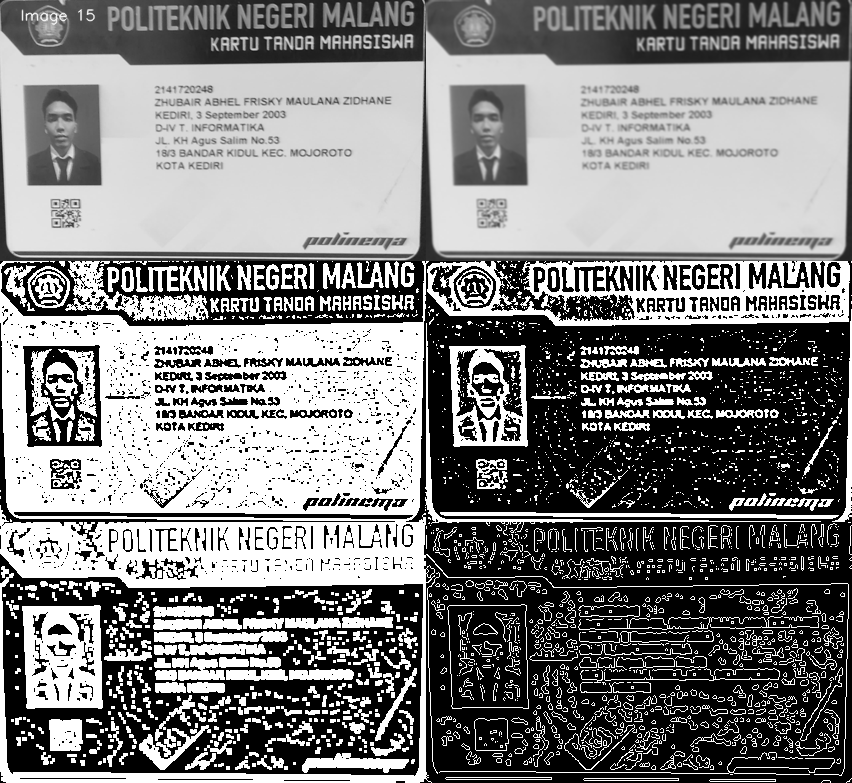

In [160]:
import cv2
import numpy as np

# Assume 'cropped_images' is a list containing your cropped images

# Display each cropped image
for i, img in enumerate(cropped_images):
    # Convert the image to grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply GaussianBlur to the grayscale image
    blur_img = cv2.GaussianBlur(gray_img, (3, 3), 0)

    # Apply Adaptive Thresholding
    threshold_img = cv2.adaptiveThreshold(blur_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 1)

    # Invert the image
    invertion = 255 - threshold_img

    # Dilation
    dilation = cv2.dilate(invertion, np.ones((3, 3)))

    # Edge Detection - Canny
    edges = cv2.Canny(dilation, 40, 150)

    # Combine original and processed images
    combined_img = np.vstack((np.hstack((gray_img, blur_img)), np.hstack((threshold_img, invertion)), np.hstack((dilation, edges))))

    # Add labels outside the combined image
    label = f'Image {i+1}'
    cv2.putText(combined_img, label, (20, 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the combined image with labels
    cv2_imshow(combined_img)

#### **7. Contour Detection**

